# **DS 203 Project**
#### by Param, Harsh, Preksha and Mohit


### **EDA + TF-IDF + HDBSCAN**
#### **Importing data and checking for missing values**



In [68]:
import pandas as pd

df = pd.read_excel("Session-Summary-for-E6-project.xlsx" , sheet_name = "Data")

# Display basic info about the dataset
print("\nDataset Info:")
df.info()

# Display the first few rows
print("\nFirst 5 rows:")
print(df.head())
print(df.tail())
# Check for missing values
print("\nMissing Values:")
print(df.isnull().sum())



Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 668 entries, 0 to 667
Data columns (total 2 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   SerialNo         668 non-null    int64 
 1   Session_Summary  668 non-null    object
dtypes: int64(1), object(1)
memory usage: 10.6+ KB

First 5 rows:
   SerialNo                                    Session_Summary
0         1  we started our lecture with a recap of previou...
1         2  in this session, we explored various feature e...
2         3  population and sample were further discussed u...
3         4  we first looked at all the summaries and obser...
4         5  midsem metrics for evaluation and also discuss...
     SerialNo                                    Session_Summary
663       664  in this lecture we have learnt about what is p...
664       665  today, we continued our discussion on statisti...
665       666  at the beginning, sir explained what are the w.

##### There were no missing values

#### **Cleaning the data**

In [69]:
import re
import pandas as pd
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

# Download stopwords
nltk.download('punkt')
nltk.download('stopwords')

# Ensure the correct column name for summaries (update if necessary)
summary_column = 'Session_Summary'
df[summary_column] = df[summary_column].astype(str)  # Convert to string

# Function to clean text
def clean_text(text):
    text = text.lower()  # Convert to lowercase
    text = re.sub(r'<.*?>', '', text)  # Remove HTML tags
    text = re.sub(r'[^a-zA-Z0-9\s]', '', text)  # Removes punctuation 
    text = re.sub(r'\s+', ' ', text).strip()  # Remove extra spaces
    tokens = word_tokenize(text)  # Tokenize text
    tokens = [word for word in tokens if word not in stopwords.words('english')]  # Remove stopwords
    return ' '.join(tokens)

# Apply cleaning function to summaries
df['cleaned_summary'] = df[summary_column].apply(clean_text)
df = df[~df['cleaned_summary'].str.startswith("https")] 
# Display cleaned summaries
print(df[['Session_Summary', 'cleaned_summary']].head())

[nltk_data] Error loading punkt: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>
[nltk_data] Error loading stopwords: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>


                                     Session_Summary  \
0  we started our lecture with a recap of previou...   
1  in this session, we explored various feature e...   
2  population and sample were further discussed u...   
3  we first looked at all the summaries and obser...   
4  midsem metrics for evaluation and also discuss...   

                                     cleaned_summary  
0  started lecture recap previous lecture particu...  
1  session explored various feature encoding tech...  
2  population sample discussed upon sample good r...  
3  first looked summaries observed graph number p...  
4  midsem metrics evaluation also discussion exer...  


##### We removed lowercase, special characters, links, extra spaces and links

In [70]:
# Check for completely empty cleaned summaries
empty_summaries = df[df['cleaned_summary'].str.strip() == '']

print(f"Found {len(empty_summaries)} empty summaries:")
print(empty_summaries[['cleaned_summary']])


Found 0 empty summaries:
Empty DataFrame
Columns: [cleaned_summary]
Index: []


In [71]:
# Check for duplicated cleaned summaries
duplicate_summaries = df[df.duplicated('cleaned_summary', keep=False)]

print(f"Found {len(duplicate_summaries)} duplicate summaries:")
print(duplicate_summaries[['cleaned_summary']])

df = df.drop_duplicates(subset='cleaned_summary', keep='first')

Found 2 duplicate summaries:
                                       cleaned_summary
301  started discussing meaning statistical signifi...
485  started discussing meaning statistical signifi...


##### Checking and removing Duplicates

In [72]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords, wordnet
from nltk.stem import WordNetLemmatizer

# Download necessary NLTK resources
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')

# Initialize tools
stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()

# Function to tokenize and lemmatize
def tokenize_and_lemmatize(text):
    tokens = word_tokenize(text)
    tokens = [t.lower() for t in tokens if t.isalpha()]             # Keep only words
    tokens = [t for t in tokens if t not in stop_words]             # Remove stopwords
    tokens = [lemmatizer.lemmatize(t) for t in tokens]              # Lemmatize
    tokens = [t for t in tokens if len(t) > 2]                      # Remove short tokens
    return tokens

# Apply to cleaned_summary column
df['tokens'] = df['cleaned_summary'].apply(tokenize_and_lemmatize)

# Create vocabulary (unique words across all tokens)
vocabulary = set(word for tokens in df['tokens'] for word in tokens)

# Show results
print(f"Total unique words in vocabulary: {len(vocabulary)}")
print("Sample tokens:", df['tokens'].head())
print("Sample vocabulary:", list(vocabulary)[:20])


[nltk_data] Error loading punkt: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>
[nltk_data] Error loading stopwords: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>
[nltk_data] Error loading wordnet: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>
[nltk_data] Error loading omw-1.4: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>


Total unique words in vocabulary: 4598
Sample tokens: 0    [started, lecture, recap, previous, lecture, p...
1    [session, explored, various, feature, encoding...
2    [population, sample, discussed, upon, sample, ...
3    [first, looked, summary, observed, graph, numb...
4    [midsem, metric, evaluation, also, discussion,...
Name: tokens, dtype: object
Sample vocabulary: ['correspond', 'intersection', 'offer', 'building', 'datasetuntil', 'appeared', 'predetermining', 'pick', 'described', 'bigger', 'majority', 'raising', 'heavily', 'uncertainty', 'variablefeature', 'nonreal', 'integration', 'tnse', 'control', 'tell']


removing stop words, lemmatizing and tokenizing

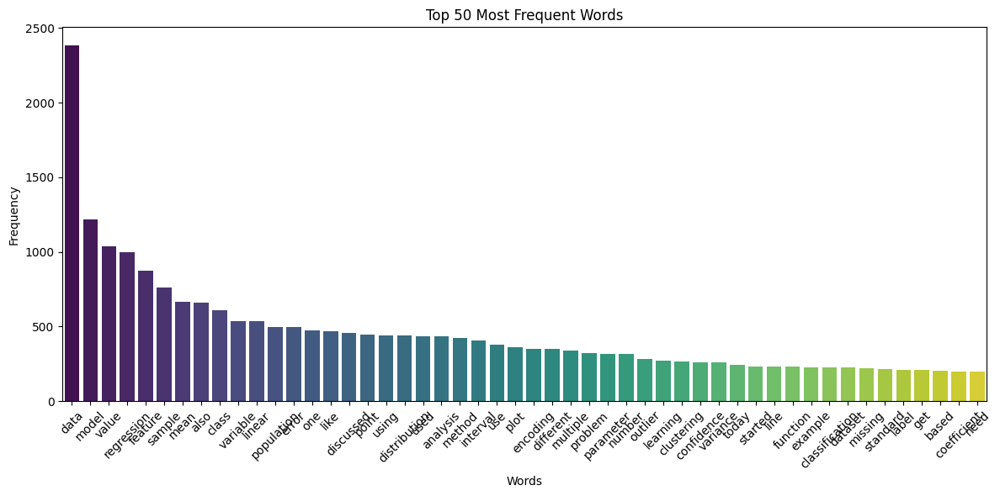

In [73]:
import matplotlib.pyplot as plt
from collections import Counter

import seaborn as sns

# 1. Token count per summary
df['token_count'] = df['tokens'].apply(len)

# 2. Frequency count of all tokens
all_tokens = [token for tokens in df['tokens'] for token in tokens]
token_freq = Counter(all_tokens)

# Top 20 most common words
top_words = token_freq.most_common(50)
words, counts = zip(*top_words)

# 3. Bar Plot of Most Common Words
plt.figure(figsize=(12, 6))
sns.barplot(x=list(words), y=list(counts), palette='viridis')
plt.title("Top 50 Most Frequent Words")
plt.xlabel("Words")
plt.ylabel("Frequency")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

We can see there are some irrelevant words which can mess up clustering after TF-IDF

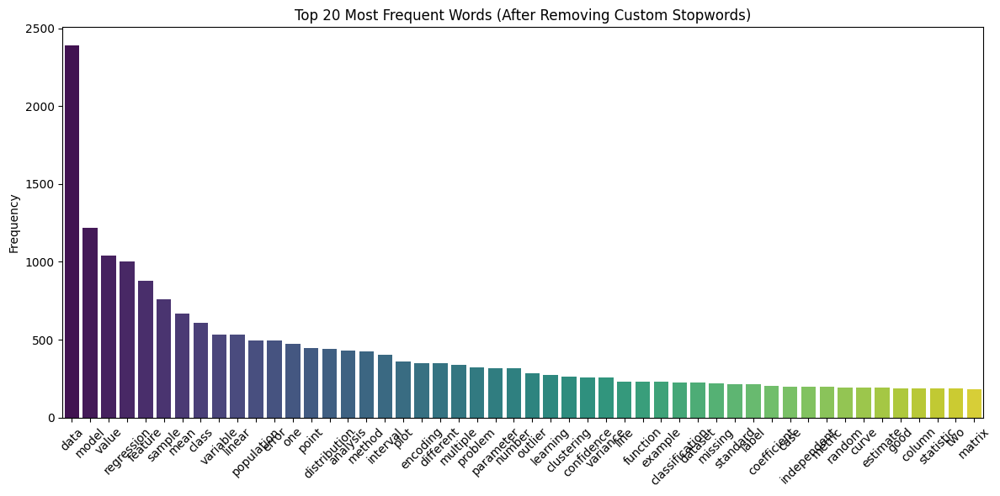

In [74]:
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns



# Define additional low-value custom stopwords
custom_stopwords = ['started','also', 'like', 'using', 'used', 'discussed', 'use','today','get','need','based']

# Flatten all tokens and filter out custom stopwords
filtered_tokens = [token for tokens in df['tokens'] for token in tokens if token not in custom_stopwords]
# Instead of flattening, filter tokens within each row's list
df['tokens'] = [[token for token in tokens if token not in custom_stopwords] 
                for tokens in df['tokens']]
# Join tokens in each row to form a cleaned summary
df['cleaned_summary'] = df['tokens'].apply(lambda tokens: ' '.join(tokens))

# Then flatten for word frequency counting
filtered_tokens = [token for tokens in df['tokens'] for token in tokens]
word_freq = Counter(filtered_tokens)
# Count word frequencies
word_freq = Counter(filtered_tokens)
common_words = word_freq.most_common(50)

# Prepare for plotting
words, counts = zip(*common_words)
plt.figure(figsize=(12, 6))
sns.barplot(x=list(words), y=list(counts), palette='viridis')
plt.xticks(rotation=45)
plt.title('Top 20 Most Frequent Words (After Removing Custom Stopwords)')
plt.ylabel('Frequency')
plt.tight_layout()
plt.show()


removing the irrelevant words which we determined by common sense and trail error


Silhouette Score (HDBSCAN + Cosine): 0.283


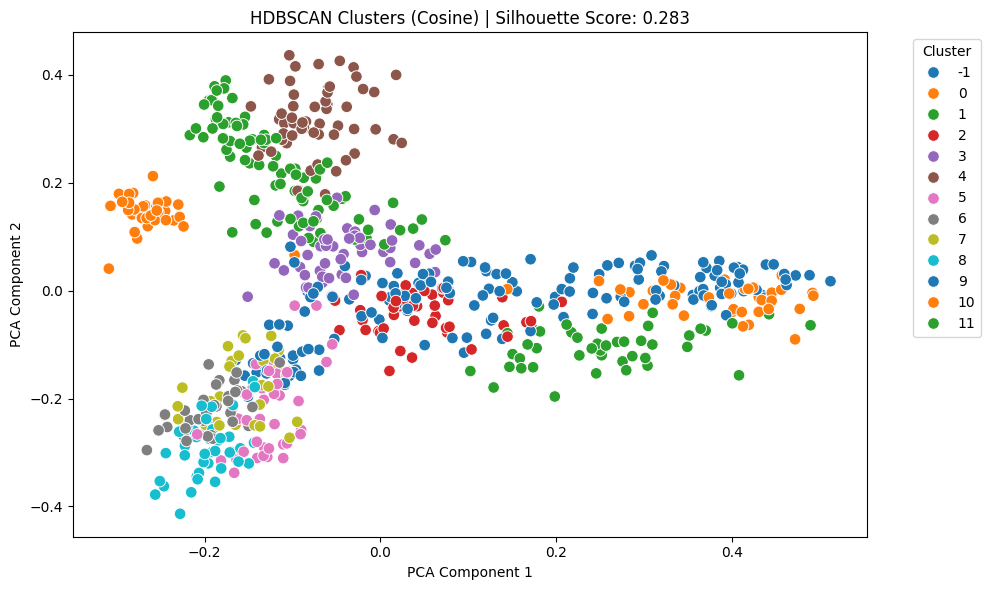

In [75]:

# Imports
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD, PCA
from sklearn.metrics import silhouette_score
from sklearn.metrics.pairwise import cosine_distances
import hdbscan
import matplotlib.pyplot as plt
import seaborn as sns

# Sample cleaned/preprocessed text data (replace with your real data)
documents = df['cleaned_summary']

# Step 1: TF-IDF Vectorization (with bigrams)
vectorizer = TfidfVectorizer(stop_words='english', ngram_range=(1, 2), max_features=1000)
tfidf_matrix = vectorizer.fit_transform(documents)

# Step 2: Dimensionality Reduction (TruncatedSVD)
svd = TruncatedSVD(n_components=50, random_state=42)
X_reduced = svd.fit_transform(tfidf_matrix)

# Step 3: Compute Cosine Distance Matrix
cosine_dist = cosine_distances(X_reduced)

# Step 4: HDBSCAN Clustering with Precomputed Cosine Distance
clusterer = hdbscan.HDBSCAN(min_cluster_size=30, min_samples=1, metric='precomputed')
labels = clusterer.fit_predict(cosine_dist)

# Step 5: Silhouette Score (exclude noise)
mask = labels != -1
if len(set(labels[mask])) > 1:
    score = silhouette_score(X_reduced[mask], labels[mask])
    print(f"Silhouette Score (HDBSCAN + Cosine): {score:.3f}")
else:
    print("Not enough clusters to compute silhouette score.")
    score = -1

# Step 6: Visualization (Optional, via PCA)
pca = PCA(n_components=2)
X_vis = pca.fit_transform(X_reduced)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_vis[:, 0], y=X_vis[:, 1], hue=labels, palette="tab10", s=70)
plt.title(f"HDBSCAN Clusters (Cosine) | Silhouette Score: {score:.3f}")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


We do the clustering using cosine similiarity because with Euclidean distance, even small differences in sparse vectors can lead to large distances while cosine uses the angle

In [76]:
from hdbscan.validity import validity_index

# DBCV + Silhouette
if len(set(labels[mask])) > 1:
    sil_score = silhouette_score(X_reduced[mask], labels[mask])
    dbcv_score = validity_index(X_reduced[mask], labels[mask], metric='euclidean')
    print(f"Silhouette Score: {sil_score:.3f}")
    print(f"DBCV Score: {dbcv_score:.3f}")
else:
    print("Not enough valid clusters to compute silhouette or DBCV scores.")

Silhouette Score: 0.283
DBCV Score: 0.135


The silhouette score indicates that the clusters are weak and the DBCV which measures the clustering wrt density also indicates weak clustering

In [77]:
# Get cluster counts (exclude noise label -1)
cluster_counts = pd.Series(labels).value_counts().drop(-1, errors='ignore').sort_values(ascending=False)

print("\nCluster Distribution:")
print("---------------------------------")
print(f"Number of clusters: {len(cluster_counts)}")
print(f"Number of noise points: {(labels == -1).sum()}")

if not cluster_counts.empty:
    print("\nElements per cluster:")
    for cluster, count in cluster_counts.items():
        print(f"Cluster {cluster}: {count} elements")
else:
    print("\nNo clusters found (all points considered noise)")


Cluster Distribution:
---------------------------------
Number of clusters: 12
Number of noise points: 109

Elements per cluster:
Cluster 1: 88 elements
Cluster 4: 55 elements
Cluster 3: 52 elements
Cluster 9: 49 elements
Cluster 11: 44 elements
Cluster 2: 43 elements
Cluster 10: 42 elements
Cluster 5: 41 elements
Cluster 8: 41 elements
Cluster 6: 38 elements
Cluster 0: 34 elements
Cluster 7: 30 elements


We get 11 clusters with 124 points considered as noise which seems decent and has realistic numbers

In [78]:
pip install umap-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


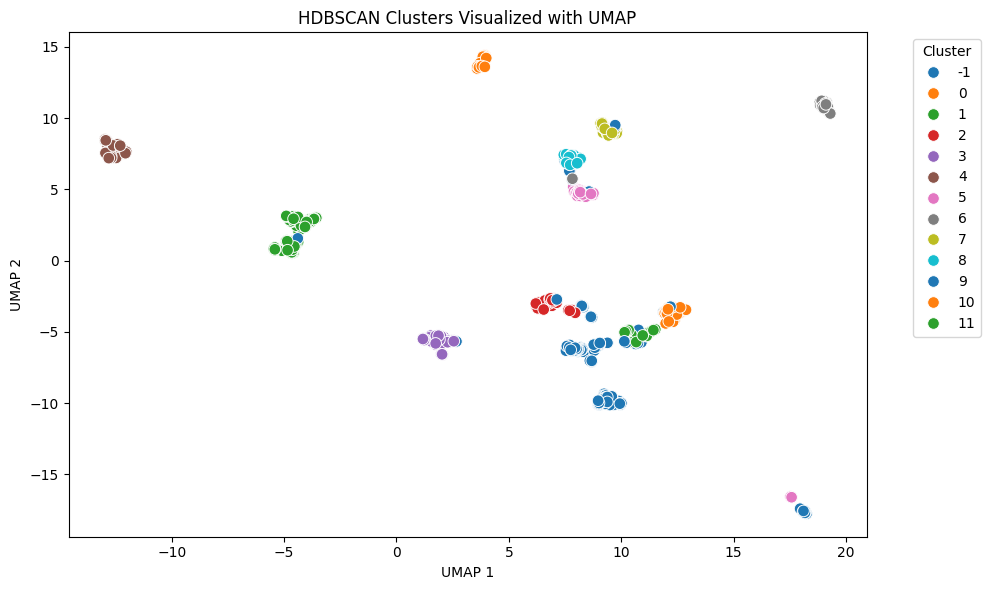

In [79]:
import umap

# Apply UMAP on reduced TF-IDF features
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1, metric='cosine', random_state=42)
X_umap = umap_model.fit_transform(X_reduced)  # You can also try tfidf_matrix or normalized NMF topics

# Build DataFrame
df['UMAP1'] = X_umap[:, 0]
df['UMAP2'] = X_umap[:, 1]

# Plot
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='UMAP1', y='UMAP2', hue=labels, palette='tab10', s=70)
plt.title("HDBSCAN Clusters Visualized with UMAP")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()



UMAP is better for visualisation compared to PCA as UMAP works better on data with high dimensionality

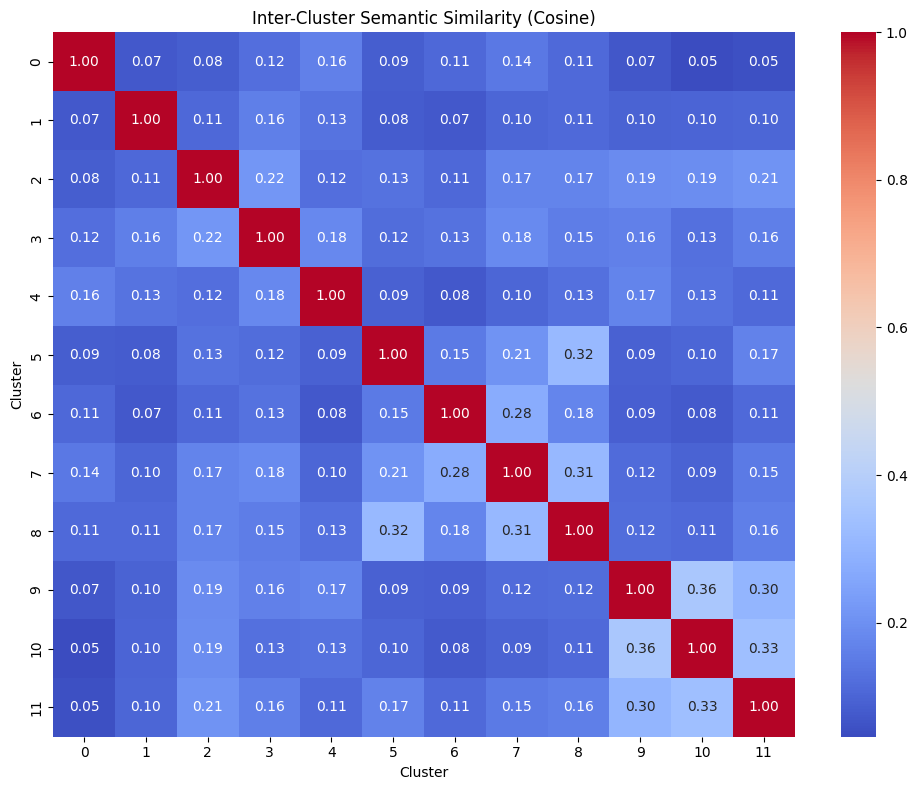

In [80]:
from sklearn.metrics.pairwise import cosine_similarity
from itertools import combinations
from collections import defaultdict
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Compute cosine similarity matrix
cosine_sim_matrix = cosine_similarity(X_reduced)

# Step 2: Define cluster similarity calculator
def compute_cluster_similarities(similarity_matrix, labels):
    clusters = defaultdict(list)
    for i, label in enumerate(labels):
        if label != -1:
            clusters[label].append(i)

    scores = {}
    for (c1, indices1), (c2, indices2) in combinations(clusters.items(), 2):
        sim_vals = similarity_matrix[np.ix_(indices1, indices2)]
        scores[(c1, c2)] = np.mean(sim_vals)
    return scores

scores = compute_cluster_similarities(cosine_sim_matrix, labels)

# Create cluster similarity heatmap
cluster_pairs = list(scores.keys())
unique_clusters = sorted(set([c for pair in cluster_pairs for c in pair]))
heatmap_data = pd.DataFrame(index=unique_clusters, columns=unique_clusters)

for (c1, c2), val in scores.items():
    heatmap_data.loc[c1, c2] = val
    heatmap_data.loc[c2, c1] = val  # Symmetric matrix

# Self-similarity (diagonal) = 1
for cluster in unique_clusters:
    heatmap_data.loc[cluster, cluster] = 1.0

# Convert to float for plotting
heatmap_data = heatmap_data.astype(float)

# Plot
plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Inter-Cluster Semantic Similarity (Cosine)")
plt.xlabel("Cluster")
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()


Clusters 8 & 9 and 9 & 10 show high semantic similarity (≥ 0.33), suggesting related topics.

Most clusters are distinct (low off-diagonal scores), indicating good separation across themes.

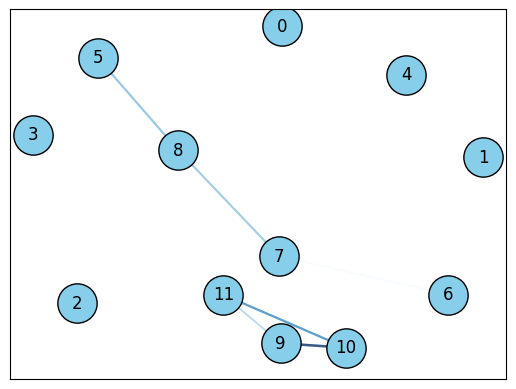

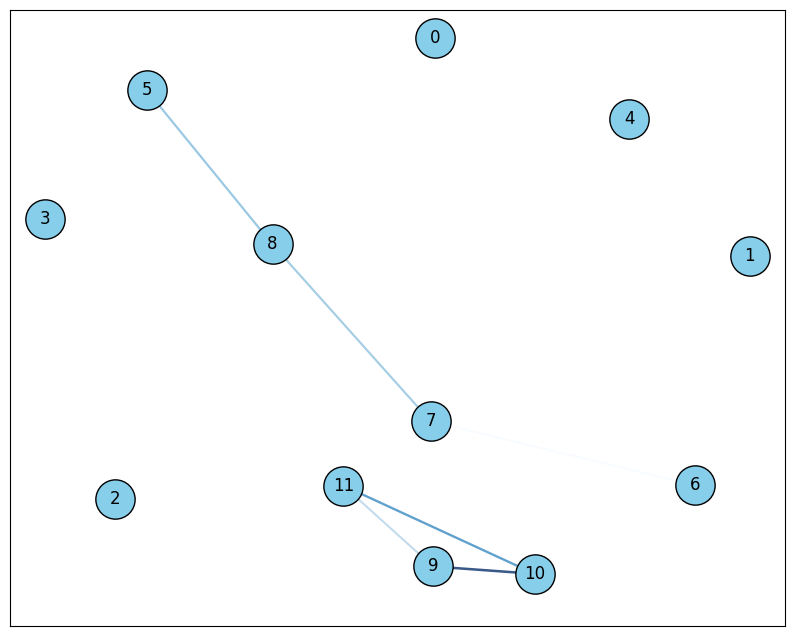

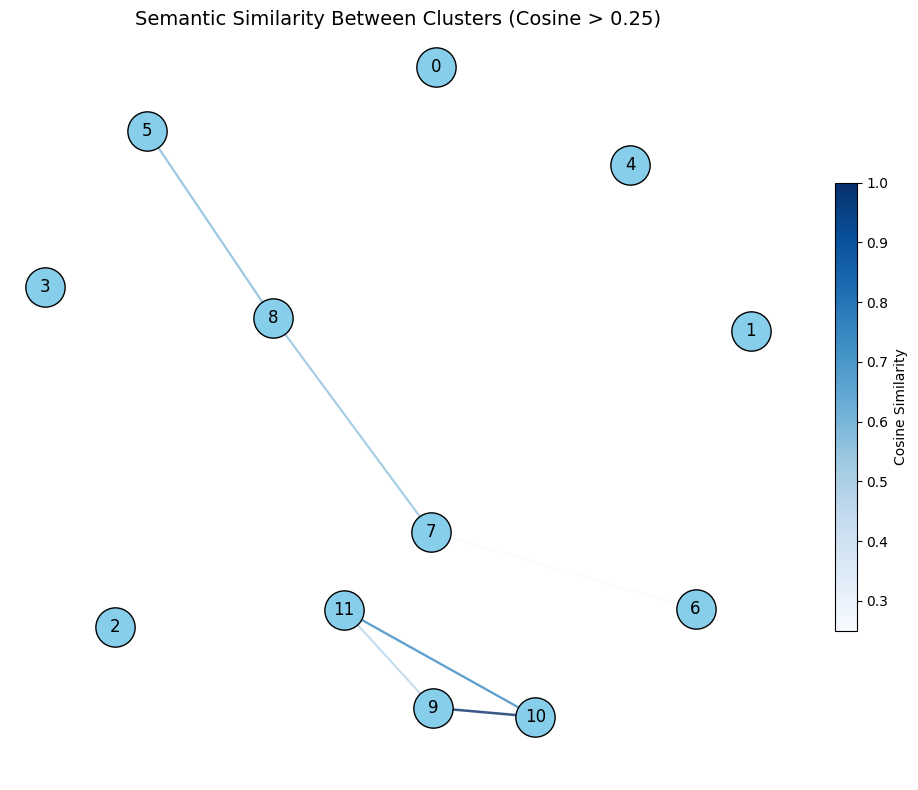

In [81]:
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
import seaborn as sns
import numpy as np

# Assuming `similarity_matrix` is the same 2D NumPy array used in your heatmap
# If you used a DataFrame, just extract it:
similarity_matrix = heatmap_data.astype(float).values
clusters = heatmap_data.columns.astype(int)

# Threshold to include edges (you can adjust this for clarity)
threshold = 0.25

# Create Graph
G = nx.Graph()

# Add nodes
for cluster in clusters:
    G.add_node(cluster)

# Add edges for pairs with similarity above threshold
for i in range(len(clusters)):
    for j in range(i + 1, len(clusters)):
        sim_score = similarity_matrix[i][j]
        if sim_score > threshold:
            G.add_edge(clusters[i], clusters[j], weight=sim_score)

# Layout (spring = force-directed)
pos = nx.spring_layout(G, seed=42, k=0.7)

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_size=800, node_color="skyblue", edgecolors="black")

# Draw labels
nx.draw_networkx_labels(G, pos, font_size=12)

# Draw edges with weight-based width and color
edges = G.edges(data=True)
weights = [d['weight'] for (_, _, d) in edges]
nx.draw_networkx_edges(
    G, pos,
    edgelist=edges,
    width=[5 * w for w in weights],
    edge_color=weights,
    edge_cmap=plt.cm.Blues,
    alpha=0.8
)

# Color bar for edge weights
fig, ax = plt.subplots(figsize=(10, 8))  # Create figure and axes before drawing

# Move all your drawing code to use `ax`
nx.draw_networkx_nodes(G, pos, ax=ax, node_size=800, node_color="skyblue", edgecolors="black")
nx.draw_networkx_labels(G, pos, ax=ax, font_size=12)
edges = G.edges(data=True)
weights = [d['weight'] for (_, _, d) in edges]
nx.draw_networkx_edges(
    G, pos, ax=ax,
    edgelist=edges,
    width=[5 * w for w in weights],
    edge_color=weights,
    edge_cmap=plt.cm.Blues,
    alpha=0.8
)

fig, ax = plt.subplots(figsize=(10, 8))  # Create figure and axes before drawing

# Move all your drawing code to use `ax`
nx.draw_networkx_nodes(G, pos, ax=ax, node_size=800, node_color="skyblue", edgecolors="black")
nx.draw_networkx_labels(G, pos, ax=ax, font_size=12)
edges = G.edges(data=True)
weights = [d['weight'] for (_, _, d) in edges]
nx.draw_networkx_edges(
    G, pos, ax=ax,
    edgelist=edges,
    width=[5 * w for w in weights],
    edge_color=weights,
    edge_cmap=plt.cm.Blues,
    alpha=0.8
)

# Add colorbar properly
sm = plt.cm.ScalarMappable(cmap=plt.cm.Blues, norm=plt.Normalize(vmin=threshold, vmax=1))
sm.set_array(weights)  # Set actual weights here
cbar = fig.colorbar(sm, ax=ax, shrink=0.6)
cbar.set_label('Cosine Similarity')

# Final plot settings
ax.set_title("Semantic Similarity Between Clusters (Cosine > 0.25)", fontsize=14)
ax.axis('off')
plt.tight_layout()
plt.show()






## Tightest Cluster: 
Nodes 8, 9, and 10 form a strongly connected triangle, indicating high mutual similarity.

## Weak Link: 
Nodes 5 and 6 are weakly connected, suggesting limited but present semantic overlap.

## Isolated Clusters: 
Nodes like 0, 1, 2, 3, 4, and 7 are isolated, showing no strong similarity with others (cosine < 0.25).

## Visual Gradient: 
Edge thickness and color reflect cosine strength — darker lines (e.g., between 8–9) indicate stronger similarity.










In [82]:
import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import normalize

# Input: already available from previous steps
# - `df['cleaned_summary']`: original summaries
# - `tfidf_matrix`: full TF-IDF matrix
# - `labels`: cluster assignments for each summary

# Add cluster labels to DataFrame
df['cluster'] = labels

# Compute detail metrics
df['word_count'] = df['cleaned_summary'].apply(lambda x: len(x.split()))
df['tfidf_norm'] = np.linalg.norm(tfidf_matrix.toarray(), axis=1)

# Normalize TF-IDF matrix
tfidf_normed = normalize(tfidf_matrix)
# Reset index to ensure alignment with matrix rows
df = df.reset_index(drop=True)

relevance_scores = []

for i in range(len(df)):
    cluster_id = df.loc[i, 'cluster']
    
    if cluster_id == -1:
        relevance_scores.append(0)
        continue

    # Get index positions of other summaries in the same cluster
    cluster_indices = df[df['cluster'] == cluster_id].index.tolist()
    
    # Slice from matrix using positions
    cluster_vectors = tfidf_normed[cluster_indices]
    
    # Compute centroid and convert to array
    centroid = np.asarray(cluster_vectors.mean(axis=0))

    # Compute cosine similarity between summary and cluster centroid
    sim = cosine_similarity(tfidf_normed[i], centroid)[0][0]
    relevance_scores.append(sim)

df['cluster_relevance'] = relevance_scores


# Combine metrics: you can tweak weights as needed
df['composite_score'] = (
    0.5 * df['cluster_relevance'] +
    0.3 * (df['tfidf_norm'] / df['tfidf_norm'].max()) +
    0.2 * (df['word_count'] / df['word_count'].max())
)

# Rank within cluster
df['cluster_rank'] = df.groupby('cluster')['composite_score'].rank(ascending=False)

# Sort to preview
ranked_summaries = df.sort_values(['cluster', 'cluster_rank'])

# Display top 5 for each cluster
for cluster_id in sorted(df['cluster'].unique()):
    if cluster_id == -1:
        continue  # skip noise
    print(f"\n=== Cluster {cluster_id} ===")
    top = ranked_summaries[ranked_summaries['cluster'] == cluster_id].head(5)
    for i, row in top.iterrows():
        print(f"  Rank {int(row['cluster_rank'])}: {row['cleaned_summary'][:150]}... [Score: {row['composite_score']:.3f}]")



=== Cluster 0 ===
  Rank 1: feature encoding technique session reviewed several technique transform categorical data numeric representation essential step getting data ready mach... [Score: 0.812]
  Rank 2: feature encoding either dependent variable independent variable categorical appropriately encoded prior training model project related assessment exer... [Score: 0.788]
  Rank 3: session explored various feature encoding technique essential converting categorical textual data numerical representation suitable machine learning m... [Score: 0.769]
  Rank 4: class covered different technique encoding categorical data feature encoding learned onehot encoding vectorization onehot encoding useful categorical ... [Score: 0.764]
  Rank 5: discussion feature encoding method either dependent independent variable categorical feature encoding technique convert numerical form work one hot en... [Score: 0.757]

=== Cluster 1 ===
  Rank 1: lecture began exploring website called playgroundtensorfl

### **EDA + SENTENCE BERT + HDBSCAN**


In [83]:
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from collections import Counter
import nltk
from nltk.tokenize import word_tokenize
from sentence_transformers import SentenceTransformer
import umap.umap_ as umap
import hdbscan
from sklearn.metrics import silhouette_score
import warnings
warnings.filterwarnings("ignore")

# Download tokenizer if needed
nltk.download('punkt')

# -----------------------------
# 1. Load and Clean Datacl

df["cleaned_summary"] = df["Session_Summary"].apply(clean_text)
texts = df["cleaned_summary"].tolist()


[nltk_data] Error loading punkt: <urlopen error [Errno 11001]
[nltk_data]     getaddrinfo failed>


importing libraries and data loading the data

. Number of summaries: 666
 Avg Word Count: 208.69
 Avg Char Count: 1265.95


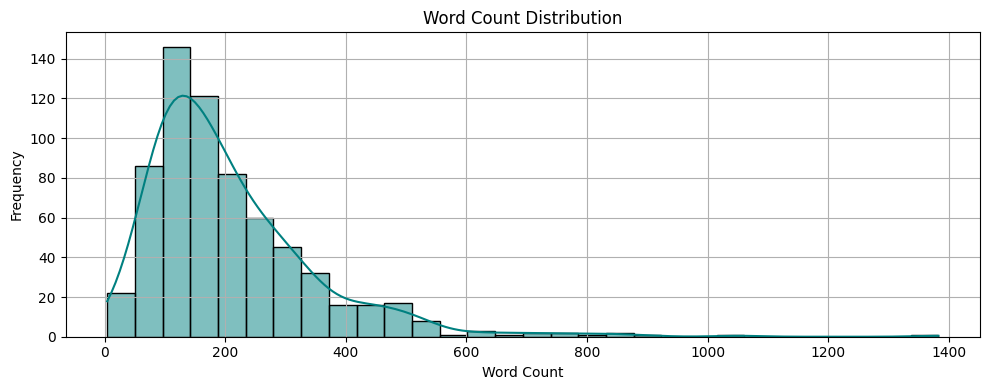

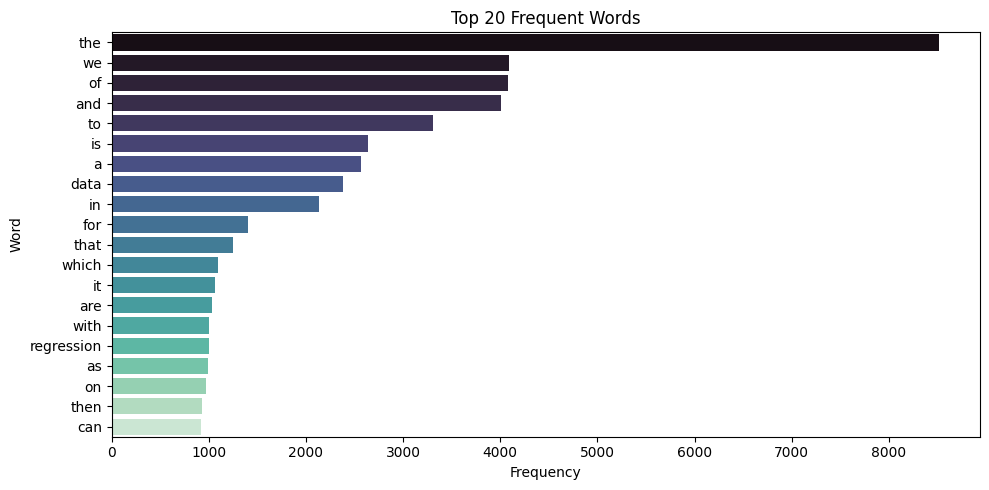

In [84]:
# Clean text
def clean_text(text):
    text = re.sub(r"http\S+|www.\S+", "", text)
    text = re.sub(r"[^a-zA-Z0-9\s]", "", text)
    return text.strip()

df["cleaned_summary"] = df["Session_Summary"].apply(clean_text)
texts = df["cleaned_summary"].tolist()

# -----------------------------
# 2. EDA
# -----------------------------
print(". Number of summaries:", len(texts))
word_counts = [len(text.split()) for text in texts]
char_counts = [len(text) for text in texts]
print(f" Avg Word Count: {np.mean(word_counts):.2f}")
print(f" Avg Char Count: {np.mean(char_counts):.2f}")

# Word count distribution
plt.figure(figsize=(10, 4))
sns.histplot(word_counts, bins=30, kde=True, color='teal')
plt.title("Word Count Distribution")
plt.xlabel("Word Count")
plt.ylabel("Frequency")
plt.grid(True)
plt.tight_layout()
plt.show()

# Most common words
all_text = ' '.join(texts).lower()
tokens = word_tokenize(all_text)
word_freq = Counter(tokens)
common_words = word_freq.most_common(20)
words, counts = zip(*common_words)

plt.figure(figsize=(10, 5))
sns.barplot(x=list(counts), y=list(words), palette="mako")
plt.title("Top 20 Frequent Words")
plt.xlabel("Frequency")
plt.ylabel("Word")
plt.tight_layout()
plt.show()


## Word Count Distribution

The majority of session texts are between 100 and 250 words, peaking near 150.
The distribution is right-skewed, with a long tail extending beyond 1000 words.
There are a few very long summaries (above 800–1400 words), indicating potential outliers.
The histogram follows a log-normal-like pattern, common in natural language word count distributions.

## Top 20 Frequent Words

Common stopwords like “the”, “we”, “of”, “and”, “to” dominate the top positions, indicating that stopword removal may be incomplete or intentionally skipped.
The word “data” is the first domain-relevant term, suggesting a strong thematic focus on data-related content.
Technical terms like “regression” appear near the bottom of the top 20, implying that more meaningful domain-specific terms occur with lower frequency.
Words like “we” and “our” reflect a narrative or report-style tone, possibly suggesting summaries are written in a descriptive, explanatory style.

 Generating SBERT Embeddings...


Batches:   0%|          | 0/21 [00:00<?, ?it/s]

 Reducing Dimensions with UMAP...
 Clustering with HDBSCAN...


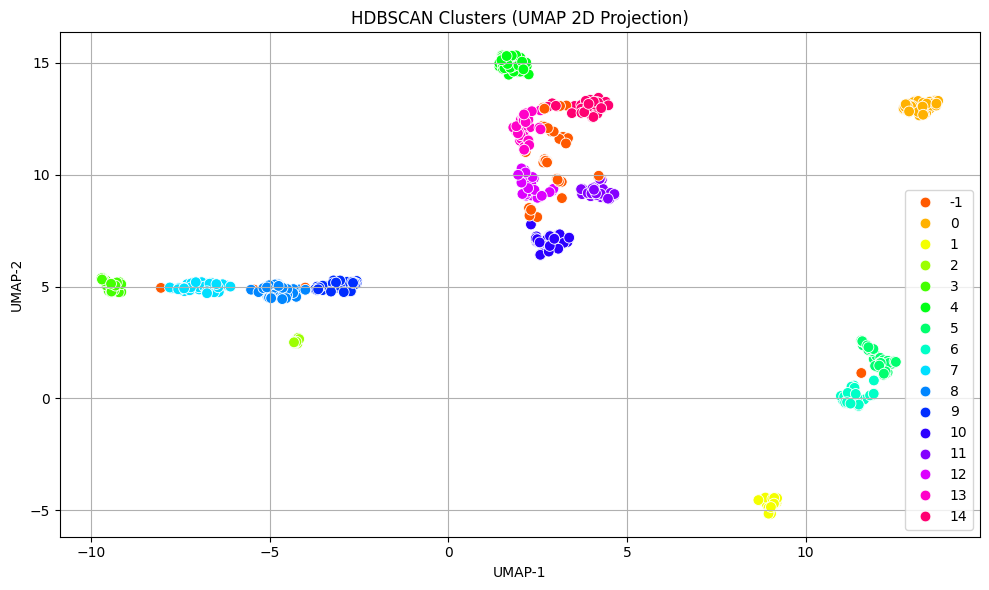

In [85]:
# -----------------------------
# 3. Embedding with Sentence-BERT
# -----------------------------
print(" Generating SBERT Embeddings...")
model = SentenceTransformer('all-MiniLM-L6-v2')  # Fast & lightweight
embeddings = model.encode(texts, show_progress_bar=True)

# -----------------------------
# 4. Dimensionality Reduction (UMAP)
# -----------------------------
print(" Reducing Dimensions with UMAP...")
umap_model = umap.UMAP(n_neighbors=15, n_components=5, metric='cosine', random_state=42)
reduced_embeddings = umap_model.fit_transform(embeddings)

# -----------------------------
# 5. Clustering with HDBSCAN
# -----------------------------
print(" Clustering with HDBSCAN...")
clusterer = hdbscan.HDBSCAN(min_cluster_size=10, metric='euclidean', cluster_selection_method='eom')
labels = clusterer.fit_predict(reduced_embeddings)

df["Cluster"] = labels

# -----------------------------
# 6. Visualize Clusters in 2D
# -----------------------------
umap_2d = umap.UMAP(n_neighbors=15, n_components=2, metric='cosine', random_state=42)
proj_2d = umap_2d.fit_transform(embeddings)

plt.figure(figsize=(10, 6))
palette = sns.color_palette("hsv", len(set(labels)))
sns.scatterplot(x=proj_2d[:, 0], y=proj_2d[:, 1], hue=labels, palette=palette, legend='full', s=60)
plt.title("HDBSCAN Clusters (UMAP 2D Projection)")
plt.xlabel("UMAP-1")
plt.ylabel("UMAP-2")
plt.grid(True)
plt.tight_layout()
plt.show()


## HDBSCAN Clusters
The UMAP plot shows clear separation among multiple clusters, indicating strong semantic or topical grouping in the data.
Cluster labels range from 0 to 13, with -1 representing noise or outliers that couldn't be confidently assigned to any cluster.
Several clusters (e.g., 3, 6, 9) are well-formed and compact, suggesting they are highly cohesive in terms of content.
Overlapping and scattered -1 points suggest there are session summaries that are ambiguous, noisy, or not similar to any dominant theme.

In [86]:

# -----------------------------
# 7. Summary
# -----------------------------
num_clusters = len(set(labels)) - (1 if -1 in labels else 0)
num_noise = list(labels).count(-1)

print("\n Clustering Summary:")
print(f" Total Clusters Found: {num_clusters}")
print(f" Noise Points: {num_noise}")
from sklearn.metrics import silhouette_score

# -----------------------------
# 8. Evaluation - Silhouette Score
# -----------------------------
# Filter out noise points for silhouette score (label -1 = noise)
mask = labels != -1
if np.sum(mask) > 1:
    sil_score = silhouette_score(reduced_embeddings[mask], labels[mask])
    print(f"\n Silhouette Score (excluding noise): {sil_score:.4f} (↑ higher is better, range -1 to 1)")
else:
    print("\n Not enough clustered points to compute Silhouette Score.")



 Clustering Summary:
 Total Clusters Found: 15
 Noise Points: 43

 Silhouette Score (excluding noise): 0.7662 (↑ higher is better, range -1 to 1)


In [87]:
from hdbscan.validity import validity_index

# Ensure input is float64 (double precision)
reduced_embeddings_64 = reduced_embeddings.astype(np.float64)

# Compute DBCV score
dbcv_score = validity_index(reduced_embeddings_64, labels, metric='euclidean')

print(f"\n🔹 DBCV Score: {dbcv_score:.4f} (↑ higher is better, range -1 to 1)")


🔹 DBCV Score: 0.5926 (↑ higher is better, range -1 to 1)


In [88]:
# -----------------------------
# Count Elements per Cluster - gives an approximation of about how many elements are there in each of the cluster 
# -----------------------------
cluster_counts = pd.Series(labels).value_counts().sort_index()

print("\n🔹 Number of Elements in Each Cluster:")
for cluster_id, count in cluster_counts.items():
    cluster_label = f"Noise (-1)" if cluster_id == -1 else f"Cluster {cluster_id}"
    print(f"{cluster_label}: {count} summaries")



🔹 Number of Elements in Each Cluster:
Noise (-1): 43 summaries
Cluster 0: 56 summaries
Cluster 1: 34 summaries
Cluster 2: 14 summaries
Cluster 3: 36 summaries
Cluster 4: 53 summaries
Cluster 5: 49 summaries
Cluster 6: 39 summaries
Cluster 7: 39 summaries
Cluster 8: 45 summaries
Cluster 9: 45 summaries
Cluster 10: 52 summaries
Cluster 11: 34 summaries
Cluster 12: 34 summaries
Cluster 13: 45 summaries
Cluster 14: 48 summaries


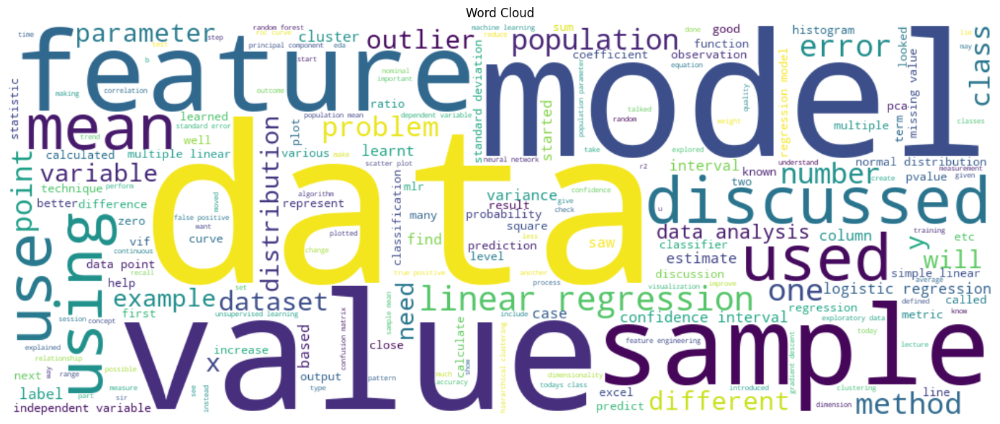

In [89]:

# Word cloud
wordcloud = WordCloud(width=1000, height=400, background_color='white').generate(all_text)
plt.figure(figsize=(15, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Word Cloud")
plt.tight_layout()
plt.show()


## Word Cloud

The most prominent terms like "sample," "data," "model," "feature," and "value" suggest a strong focus on data science fundamentals and machine learning.
Words such as "regression," "classification," "cluster," and "error" indicate frequent discussion of supervised and unsupervised learning techniques.
Statistical terms like "mean," "interval," "population," "estimate," and "confidence" reflect a substantial emphasis on inferential statistics and analysis.
Usage of verbs like "discussed," "used," "learnt," and "started" highlights a lecture or session-based educational context, where concepts were actively explained or explored.

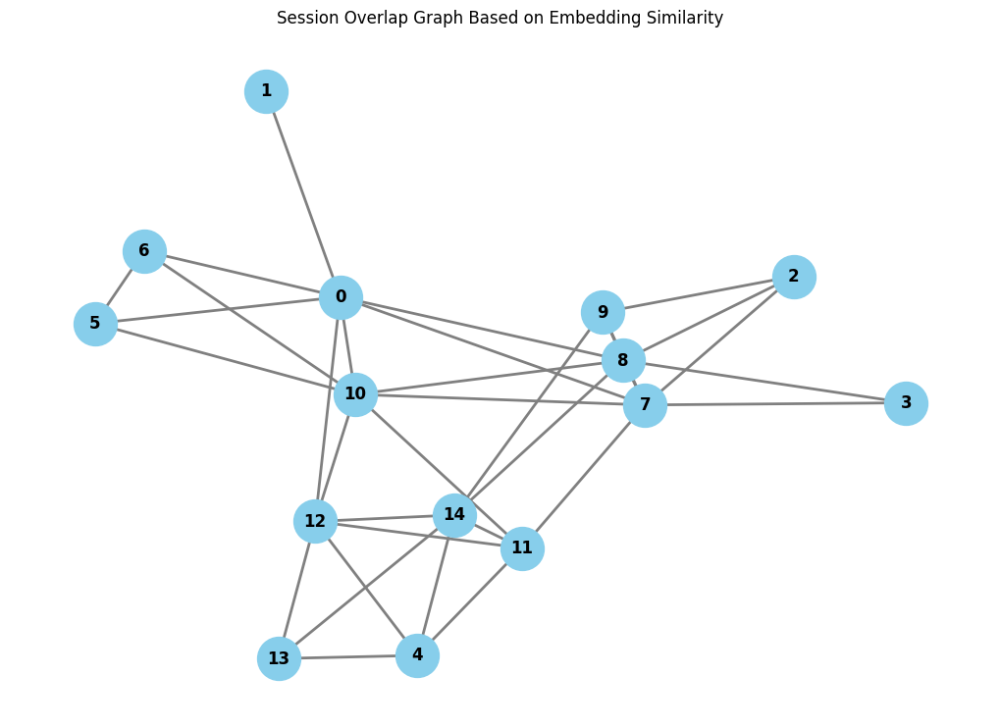

In [90]:
# ---------------------------------------------
# 3. Overlap Visualization Between Sessions
# ---------------------------------------------
from sklearn.metrics.pairwise import cosine_similarity
import networkx as nx
import matplotlib.pyplot as plt

# Compute cluster centroids
df_filtered = df[df['Cluster'] != -1]
session_vectors = df_filtered.groupby("Cluster")['cleaned_summary'].apply(list)
session_embeddings = session_vectors.apply(lambda x: model.encode(x)).apply(np.mean, axis=0)

# Cosine similarity between cluster centroids
session_ids = session_embeddings.index.tolist()
centroids = np.stack(session_embeddings.values)
sim_matrix = cosine_similarity(centroids)

# Create graph
G = nx.Graph()
for i, sid in enumerate(session_ids):
    G.add_node(sid)
    for j in range(i+1, len(session_ids)):
        if sim_matrix[i, j] > 0.5:
            G.add_edge(session_ids[i], session_ids[j], weight=sim_matrix[i, j])

plt.figure(figsize=(10, 7))
pos = nx.spring_layout(G, seed=42)
nx.draw(G, pos, with_labels=True, node_size=1000, node_color="skyblue", edge_color="gray", width=2, font_weight="bold")
plt.title("Session Overlap Graph Based on Embedding Similarity")
plt.tight_layout()
plt.show()

## High Centrality Nodes: 
Nodes 0, 6, 10, and 13 have many connections, acting as semantic hubs across sessions.

## Dense Subgraph: 
There's a dense cluster formed by nodes 6, 7, 8, 9, 10, 11, and 13, indicating strong thematic overlap.

## Peripheral Nodes: 
Nodes like 1 and 4 have fewer connections, implying more unique or isolated content.

## Collaborative Structure: 
The graph suggests significant session interlinkage, pointing to shared themes across multiple clusters.

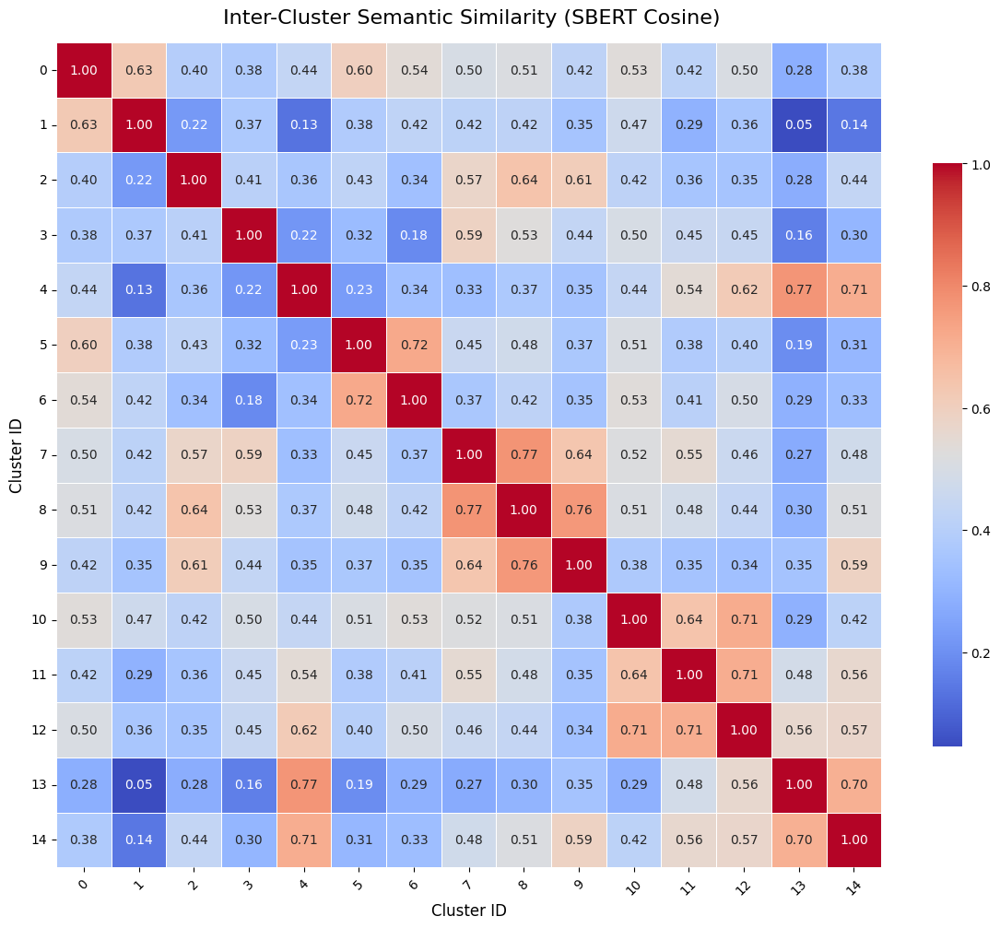

In [91]:
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# -----------------------------
# 1. Compute cluster centroids
# -----------------------------
valid_clusters = df[df['Cluster'] != -1].copy()
cluster_texts = valid_clusters.groupby("Cluster")["cleaned_summary"].apply(list)

# Average SBERT embedding per cluster
cluster_embeddings = cluster_texts.apply(lambda summaries: 
    np.mean(model.encode(summaries), axis=0))

# Create similarity matrix (cosine)
cluster_ids = cluster_embeddings.index.tolist()
centroid_matrix = np.stack(cluster_embeddings.values)
similarity_matrix = cosine_similarity(centroid_matrix)

# -----------------------------
# 2. Create annotated heatmap
# -----------------------------
heatmap_df = pd.DataFrame(similarity_matrix, index=cluster_ids, columns=cluster_ids)

plt.figure(figsize=(12, 10))
sns.heatmap(heatmap_df, annot=True, fmt=".2f", cmap="coolwarm", 
            linewidths=0.5, square=True, cbar_kws={"shrink": 0.7})

plt.title(" Inter-Cluster Semantic Similarity (SBERT Cosine)", fontsize=16, pad=15)
plt.xlabel("Cluster ID", fontsize=12)
plt.ylabel("Cluster ID", fontsize=12)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()


## Strongest Connections: 
Cluster pairs (6,8), (8,10), and (5,13) show high cosine similarity (~0.76+), indicating strong thematic overlap.

## Low Similarity Outliers: 
Cluster 1 shows weak similarity with most others, suggesting it contains more distinct content.

## Dense Middle Block: 
Clusters 6 to 11 share moderate-to-high similarity, forming a semantically cohesive group.

## Diagonal Dominance: 
All diagonals are 1.0, confirming perfect self-similarity as expected in such matrices.

In [98]:
# Here we are giving the top 5 summaries of each of the cluster , where the summaries are in cleaned format , with no special characters for example .


import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import normalize
from sentence_transformers import SentenceTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

# Assuming 'df' is your main DataFrame and contains 'cleaned_summary' and 'Cluster' columns

# Step 1: Filter out noise and reset index
df_filtered = df[df['Cluster'] != -1].reset_index(drop=True)

# Step 2: Generate SBERT embeddings per summary
model = SentenceTransformer('all-MiniLM-L6-v2')  # Use any appropriate model
embeddings = np.stack(df_filtered['cleaned_summary'].apply(lambda x: model.encode(x)))
df_filtered['SBERT_Embedding'] = list(embeddings)

# Step 3: Compute TF-IDF matrix
tfidf_vectorizer = TfidfVectorizer(max_features=1000, stop_words='english')
tfidf_matrix = tfidf_vectorizer.fit_transform(df_filtered['cleaned_summary'])
df_filtered['tfidf_norm'] = np.linalg.norm(tfidf_matrix.toarray(), axis=1)

# Step 4: Compute additional features
df_filtered['word_count'] = df_filtered['cleaned_summary'].apply(lambda x: len(x.split()))

# Step 5: Normalize TF-IDF matrix for cosine similarity
tfidf_normed = normalize(tfidf_matrix)

# Step 6: Compute cluster-level centroids and relevance scores
relevance_scores = []

for i in range(len(df_filtered)):
    cluster_id = df_filtered.loc[i, 'Cluster']
    cluster_indices = df_filtered[df_filtered['Cluster'] == cluster_id].index.tolist()
    cluster_vectors = tfidf_normed[cluster_indices]
    centroid = np.asarray(cluster_vectors.mean(axis=0))
    sim = cosine_similarity(tfidf_normed[i], centroid)[0][0]
    relevance_scores.append(sim)

df_filtered['cluster_relevance'] = relevance_scores

# Step 7: Composite Score (weights can be adjusted)
df_filtered['composite_score'] = (
    0.5 * df_filtered['cluster_relevance'] +
    0.3 * (df_filtered['tfidf_norm'] / df_filtered['tfidf_norm'].max()) +
    0.2 * (df_filtered['word_count'] / df_filtered['word_count'].max())
)

# Step 8: Ranking within cluster
df_filtered['cluster_rank'] = df_filtered.groupby('Cluster')['composite_score'].rank(ascending=False)

# Step 9: Display top 5 per cluster
ranked_summaries = df_filtered.sort_values(['Cluster', 'cluster_rank'])

for cluster_id in sorted(df_filtered['Cluster'].unique()):
    print(f"\n=== Cluster {cluster_id} ===")
    top = ranked_summaries[ranked_summaries['Cluster'] == cluster_id].head(5)
    for i, row in top.iterrows():
        print(f"  Rank {int(row['cluster_rank'])}: {row['cleaned_summary'][:150]}... [Score: {row['composite_score']:.3f}]")




=== Cluster 0 ===
  Rank 1: we started with the equation yfx for fluid flowing in pipe where we have the values of the inputs ie flow values and output temperature earlier people... [Score: 0.713]
  Rank 2: first of all we learnt about names of different types of techniques like slr which is simple linear regression multiple linear regression logistic reg... [Score: 0.706]
  Rank 3: so todays discussion start with two types of machine learning model which is supervised and unsupervised for example supervised ml includes  simple li... [Score: 0.697]
  Rank 4: ds 203 15 january 2025 3rd lecture
sir started by talking about y  fx he first talked about old and new methods of data analysis for this he took the ... [Score: 0.685]
  Rank 5: in this lecture we started by looking at how results were used to be predicted earlier without any ml models people used to collect data through exper... [Score: 0.684]

=== Cluster 1 ===
  Rank 1: feature encoding techniques

during this session we revie

In [111]:
# Assuming 'summary' is the original, uncleaned version in df
df_filtered = pd.merge(
    df_filtered,
    df[['cleaned_summary', 'Session_Summary']],
    on='cleaned_summary',
    how='left',
    suffixes=('_filtered', '_original')  # Adding suffixes to avoid duplicate column names
)

# Displaying top 5 per cluster using original summary text
ranked_summaries = df_filtered.sort_values(['Cluster', 'cluster_rank'])

for cluster_id in sorted(df_filtered['Cluster'].unique()):
    print(f"\n=== Cluster {cluster_id} ===")
    top = ranked_summaries[ranked_summaries['Cluster'] == cluster_id].head(5)
    for i, row in top.iterrows():
        print(f"  Rank {int(row['cluster_rank'])}: {row['Session_Summary_original'][:150]}... [Score: {row['composite_score']:.3f}]")



=== Cluster 0 ===
  Rank 1: we started with the equation y=f(x) (for fluid flowing in pipe) where we have the values of the inputs (i.e. flow values) and output (temperature). ea... [Score: 0.713]
  Rank 2: first of all we learnt about names of different types of techniques like slr which is simple linear regression, multiple linear regression ,logistic r... [Score: 0.706]
  Rank 3: so today's discussion start with two types of machine learning model which is supervised and unsupervised. for example supervised ml includes - simple... [Score: 0.697]
  Rank 4: ds 203 15 january, 2025 (3rd lecture)
sir started by talking about y = f(x). he first talked about old and new methods of data analysis. for this he t... [Score: 0.685]
  Rank 5: in this lecture we started by looking at how results were used to be predicted earlier, without any ml models. people used to collect data, through ex... [Score: 0.684]

=== Cluster 1 ===
  Rank 1: feature encoding techniques

during this session, we revi

In [117]:
# Save top 5 summaries of each session from the original summaries per cluster to CSV
top_summaries = ranked_summaries.groupby('Cluster').head(5)

# Use the original (uncleaned) session summaries column after merge
top_summaries[['Cluster', 'cluster_rank', 'composite_score', 'Session_Summary_original']].to_csv('top_summaries_per_cluster.csv', index=False)


In [95]:
from sklearn.preprocessing import MinMaxScaler
import plotly.express as px




# --- Group summaries per cluster ---
cluster_summary = df_filtered.groupby("Cluster").agg({
    "cleaned_summary": lambda x: " ".join(x),
    "cleaned_summary": "count"
}).rename(columns={"cleaned_summary": "SessionCount"})

# Recompute combined summary in a separate step since we reused the column
cluster_summary["combined_summary"] = df_filtered.groupby("Cluster")["cleaned_summary"].apply(lambda x: " ".join(x))

# --- TF-IDF to extract keyword importance ---
tfidf = TfidfVectorizer(max_features=1000, stop_words='english')
tfidf_matrix = tfidf.fit_transform(cluster_summary["combined_summary"])
important_keyword_counts = (tfidf_matrix > 0).sum(axis=1).A1  # Count of unique important keywords per cluster

# --- Normalize bubble sizes ---
scaler = MinMaxScaler(feature_range=(10, 100))
bubble_sizes = scaler.fit_transform(important_keyword_counts.reshape(-1, 1)).flatten()

# --- Build DataFrame for Plotly ---
bubble_df = cluster_summary.copy()
bubble_df["KeywordCount"] = important_keyword_counts
bubble_df["BubbleSize"] = bubble_sizes
bubble_df["Cluster"] = bubble_df.index.astype(str)

# --- Plot ---
fig = px.scatter(
    bubble_df,
    x="Cluster",
    y=[1] * len(bubble_df),
    size="BubbleSize",
    color="KeywordCount",
    color_continuous_scale="Viridis",
    text="Cluster",
    hover_data={
        "SessionCount": True,
        "KeywordCount": True,
        "BubbleSize": False,
        "combined_summary": False
    },
    title="💬 Cluster Bubble Chart: Important Keyword Richness per Cluster",
    labels={"x": "Cluster", "y": ""}
)

fig.update_traces(textposition="top center")
fig.update_yaxes(visible=False)
fig.update_layout(
    xaxis_title="Cluster",
    plot_bgcolor='white',
    paper_bgcolor='white',
    showlegend=False
)

fig.show()


Cluster 8 stands out with the largest bubble, indicating it has the highest keyword richness (over 650 keywords).

Clusters 7 and 10 also show higher keyword counts compared to others, though their bubbles are smaller than Cluster 3.

Clusters 0, 1, 2, 11, 12, and 13 have smaller bubbles, suggesting lower keyword richness (closer to 500 keywords).

The color gradient shows that keyword richness generally increases from left to right across clusters, with a few exceptions like Cluster 6, which is notably rich.

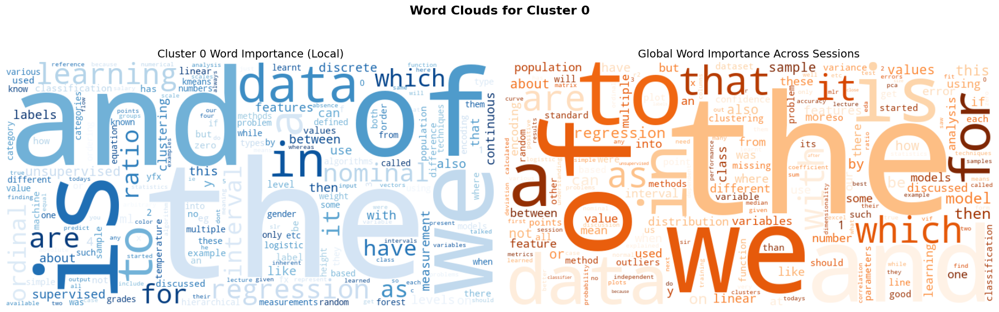

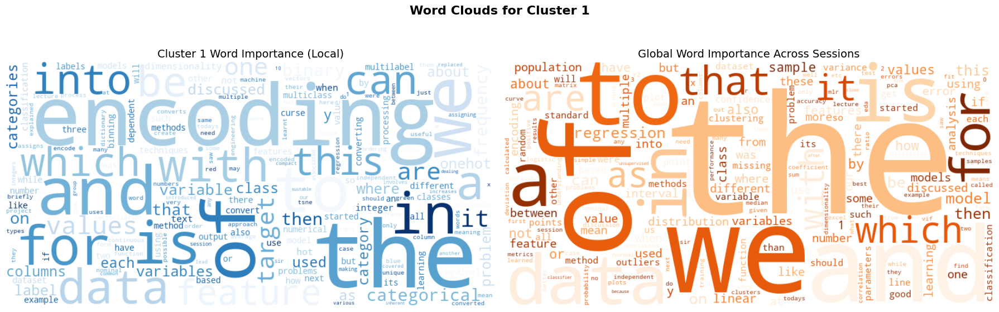

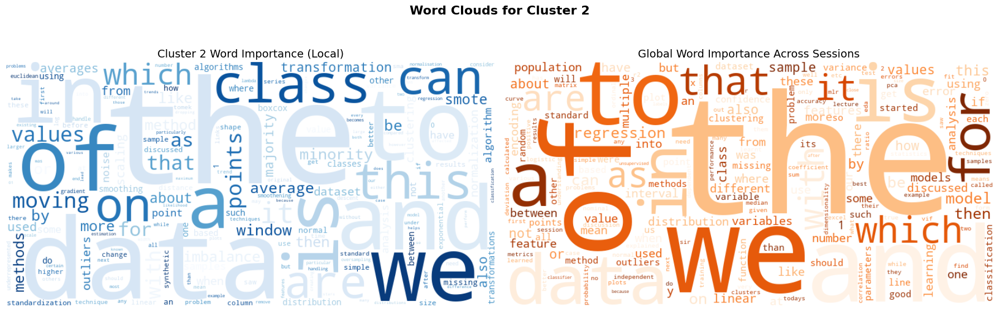

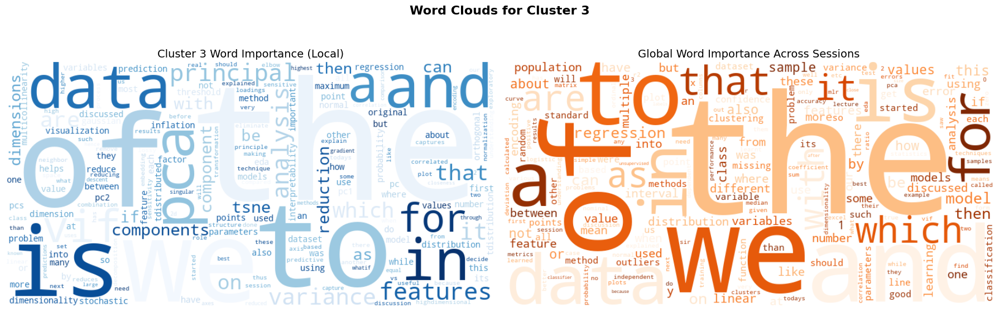

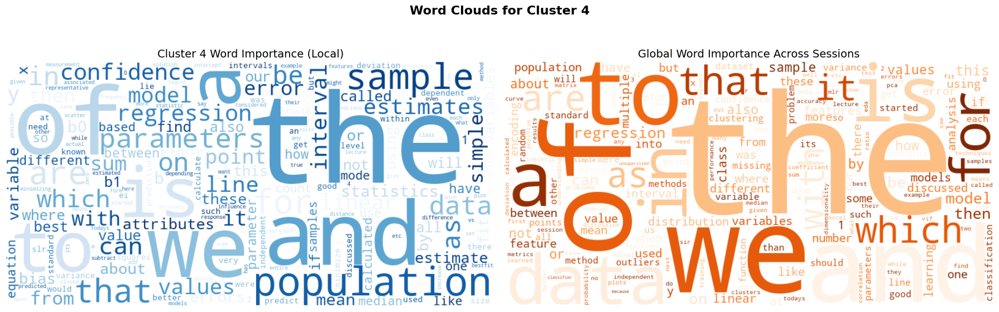

...

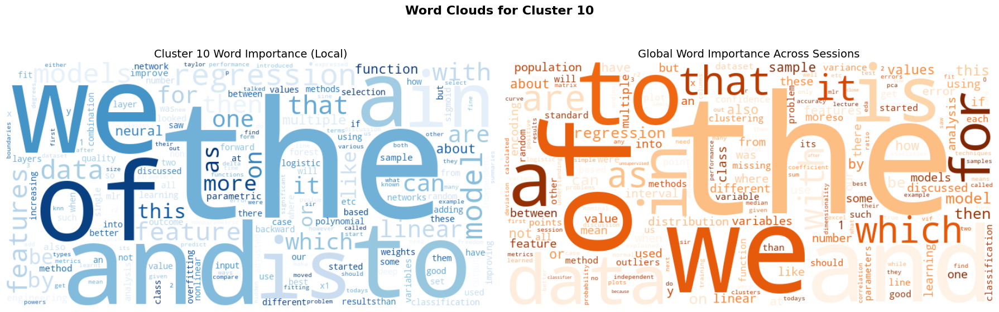

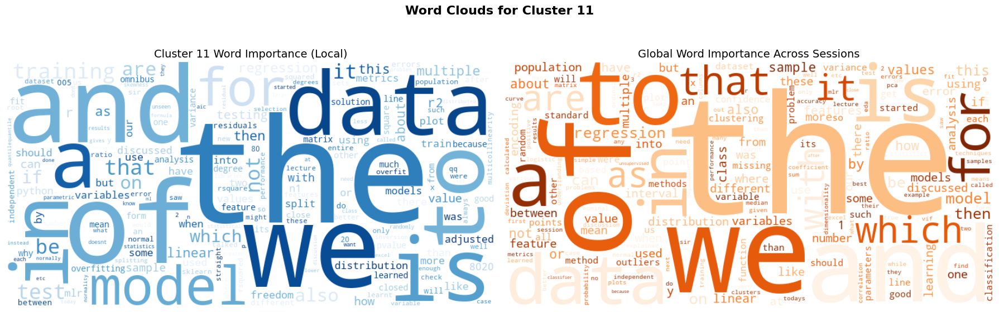

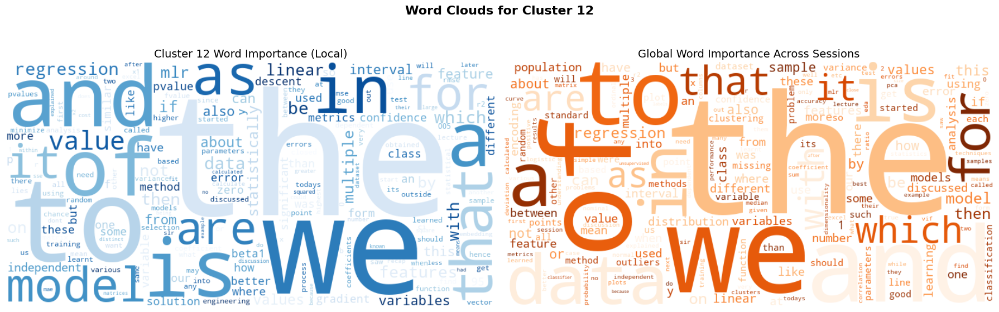

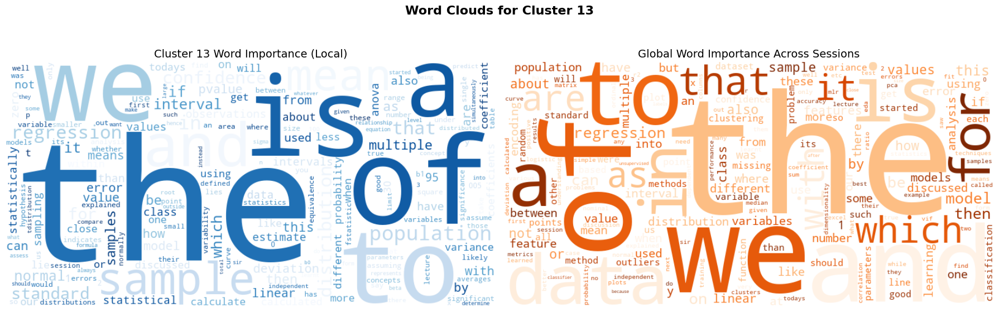

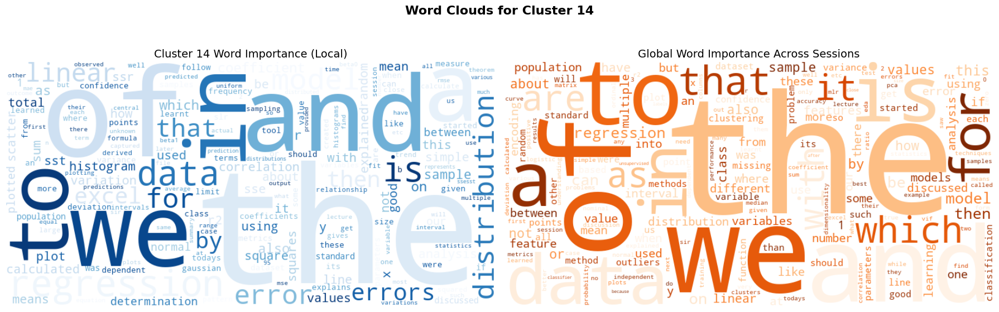

In [96]:
# in the world clouds shown below we are not removing stop words thus we would get at times "the" in bigger font . 
# Also here we compare side by side the word cloud of the particular session with the word cloud of the overall session . 

from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter

# Get list of valid clusters
valid_clusters = df_filtered['Cluster'].unique()
global_text = ' '.join(df_filtered["cleaned_summary"].tolist())

# Generate global word frequencies once
global_tokens = global_text.lower().split()
global_freq = Counter(global_tokens)

# Create global word cloud
wordcloud_global = WordCloud(width=800, height=400, background_color='white', colormap='Oranges')\
                    .generate_from_frequencies(global_freq)

# Loop through each cluster and generate session word cloud
for cluster_id in sorted(valid_clusters):
    if cluster_id == -1:
        continue  # skip noise cluster

    # Collect text for this cluster
    cluster_texts = df_filtered[df_filtered["Cluster"] == cluster_id]["cleaned_summary"].tolist()
    cluster_text = ' '.join(cluster_texts).lower()
    cluster_tokens = cluster_text.split()
    cluster_freq = Counter(cluster_tokens)

    # Create session word cloud
    wordcloud_session = WordCloud(width=800, height=400, background_color='white', colormap='Blues')\
                            .generate_from_frequencies(cluster_freq)

    # Plot side-by-side
    fig, axs = plt.subplots(1, 2, figsize=(18, 6))
    axs[0].imshow(wordcloud_session, interpolation='bilinear')
    axs[0].set_title(f"Cluster {cluster_id} Word Importance (Local)", fontsize=14)
    axs[0].axis("off")

    axs[1].imshow(wordcloud_global, interpolation='bilinear')
    axs[1].set_title("Global Word Importance Across Sessions", fontsize=14)
    axs[1].axis("off")

    plt.suptitle(f"Word Clouds for Cluster {cluster_id}", fontsize=16, fontweight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


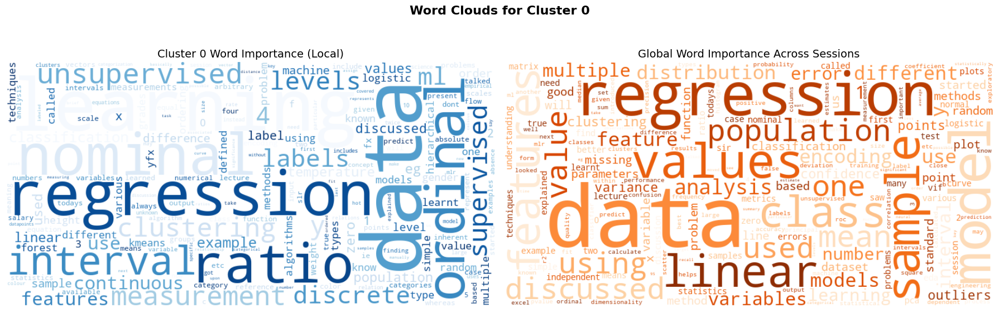

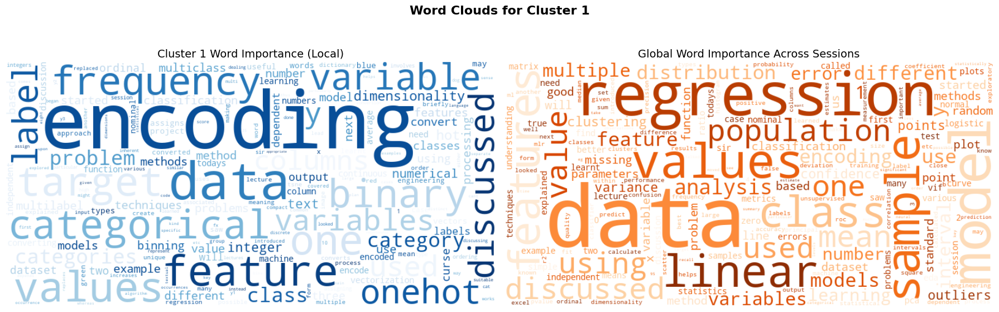

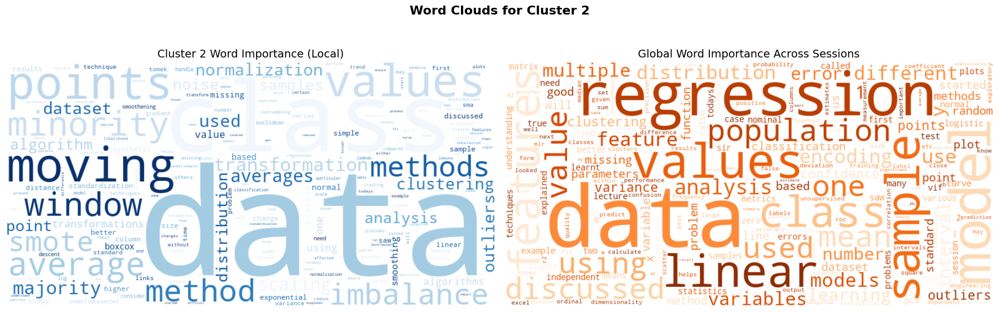

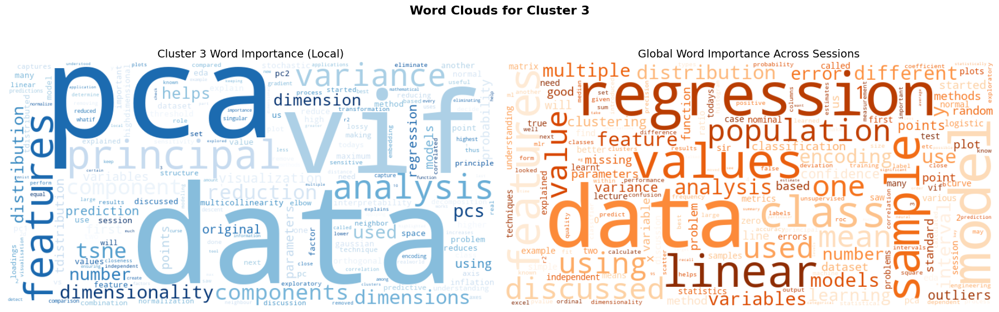

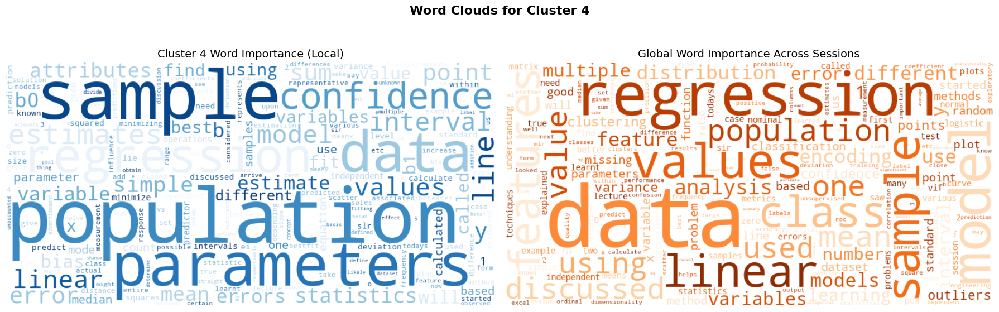

...

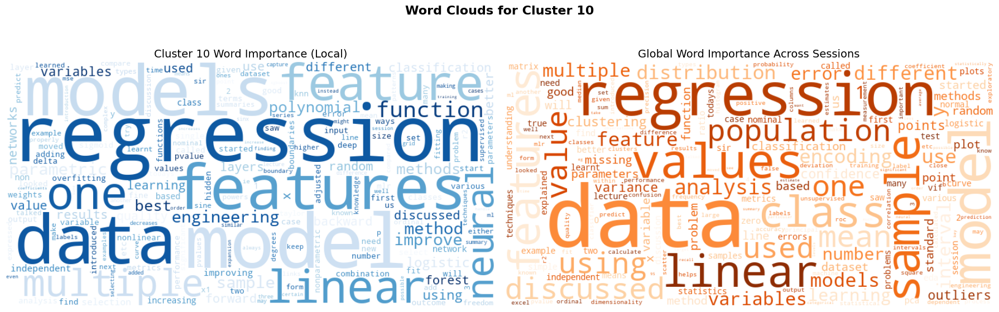

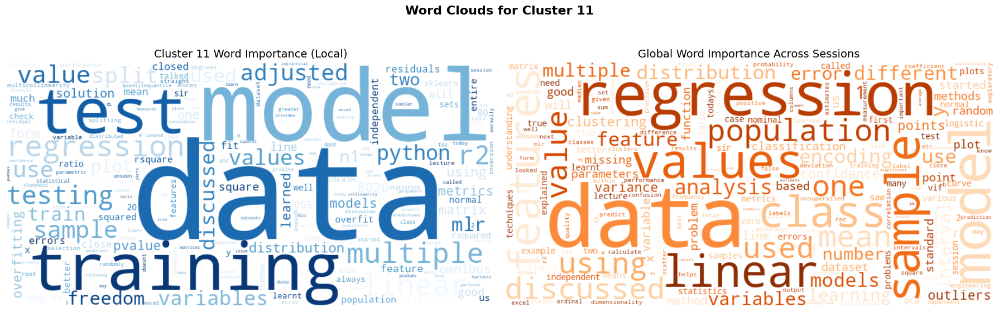

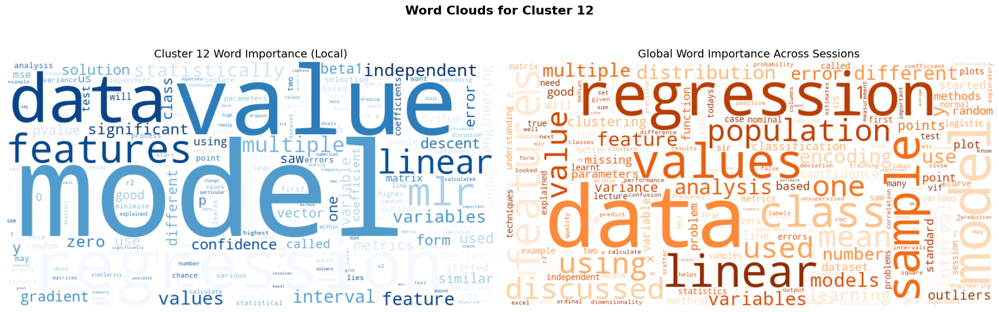

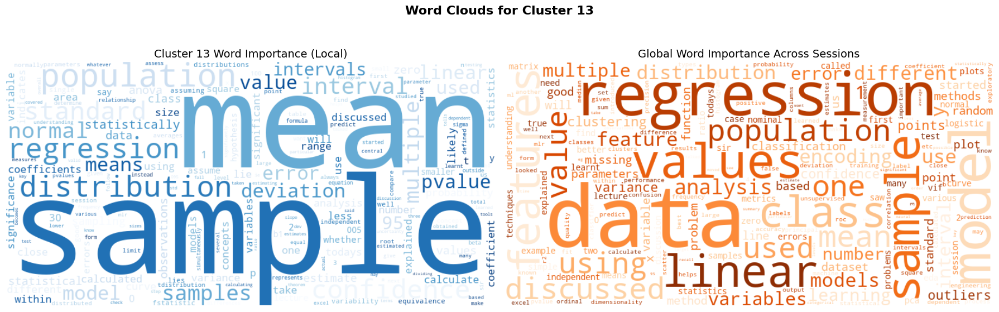

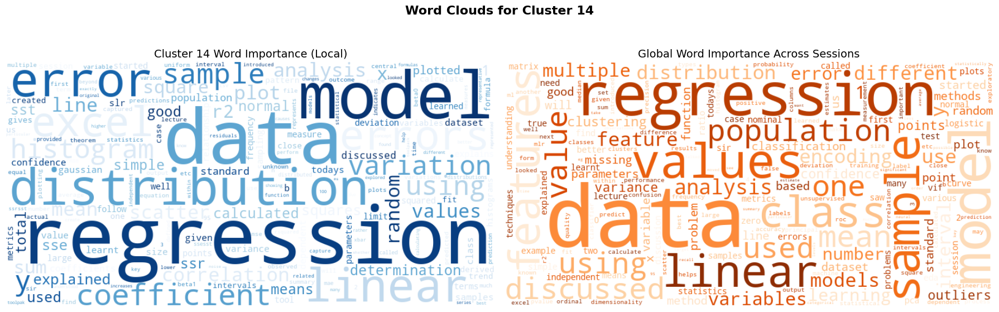

In [97]:
# in the world clouds shown below we are removing stop words thus we would not get "the" rather some different word . 
# Also here we compare side by side the word cloud of the particular session with the word cloud of the overall session . 

from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
from collections import Counter

# Define stopwords
stopwords = set(STOPWORDS)

# Get list of valid clusters
valid_clusters = df_filtered['Cluster'].unique()
global_text = ' '.join(df_filtered["cleaned_summary"].tolist())

# Tokenize and remove stopwords from global text
global_tokens = [word for word in global_text.lower().split() if word not in stopwords]
global_freq = Counter(global_tokens)

# Create global word cloud
wordcloud_global = WordCloud(width=800, height=400, background_color='white', colormap='Oranges')\
                    .generate_from_frequencies(global_freq)

# Loop through each cluster and generate session word cloud
for cluster_id in sorted(valid_clusters):
    if cluster_id == -1:
        continue  # skip noise cluster

    # Collect and clean cluster-specific text
    cluster_texts = df_filtered[df_filtered["Cluster"] == cluster_id]["cleaned_summary"].tolist()
    cluster_text = ' '.join(cluster_texts).lower()
    cluster_tokens = [word for word in cluster_text.split() if word not in stopwords]
    cluster_freq = Counter(cluster_tokens)

    # Create session word cloud
    wordcloud_session = WordCloud(width=800, height=400, background_color='white', colormap='Blues')\
                            .generate_from_frequencies(cluster_freq)

    # Plot side-by-side
    fig, axs = plt.subplots(1, 2, figsize=(18, 6))
    axs[0].imshow(wordcloud_session, interpolation='bilinear')
    axs[0].set_title(f"Cluster {cluster_id} Word Importance (Local)", fontsize=14)
    axs[0].axis("off")

    axs[1].imshow(wordcloud_global, interpolation='bilinear')
    axs[1].set_title("Global Word Importance Across Sessions", fontsize=14)
    axs[1].axis("off")

    plt.suptitle(f"Word Clouds for Cluster {cluster_id}", fontsize=16, fontweight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
